In [1]:
# from datafed.CommandLib import API
# df_api = API()

# RHEED Metrics with Details

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import sys
sys.path.append('../../src/')

import os
import re
import numpy as np
import matplotlib.pyplot as plt

from m3_learning.util.file_IO import download_and_unzip
from m3_learning.RHEED.Dataset import RHEED_spot_Dataset, RHEED_parameter_dataset
from m3_learning.RHEED.Viz import Viz
from m3_learning.RHEED.Fit import RHEED_image_processer, Gaussian
from m3_learning.RHEED.Analysis_umich import analyze_rheed_data

In [7]:
import glob
glob.glob('E:/umich_rheed/*.h5')

['E:/umich_rheed\\J14_set2_300C_data_08252023.h5',
 'E:/umich_rheed\\J14_set2_350C_08252023.h5',
 'E:/umich_rheed\\sto_sto_08232023.h5',
 'E:/umich_rheed\\sto_sto_gaussian_fit_parameters_08232023.h5']

In [9]:
path = 'E:/umich_rheed/J14_set2_350C_08252023.h5'
D1_spot = RHEED_spot_Dataset(path, sample_name='J14_set2')
D1_spot.data_info

Growth: temp350, Size of data: f(477178, 480, 640)


In [12]:
path = 'E:/umich_rheed/J14_set2_300C_data_08252023.h5'
D1_spot = RHEED_spot_Dataset(path, sample_name='J14_set2')
D1_spot.data_info

Growth: temp300, Size of data: f(366525, 480, 640)
Growth: temp300_later_stage, Size of data: f(172714, 480, 640)


In [10]:
path = 'F:/UMich/J14_set2_250C_08252023.h5'
D1_spot = RHEED_spot_Dataset(path, sample_name='J14_set2')
D1_spot.data_info

Growth: temp250, Size of data: f(499922, 480, 640)
Growth: temp250_later_stage, Size of data: f(509165, 480, 640)


### 2.1 J14_set_2_350C

#### 2.1.1 Loading the Dataset

In [2]:
path = 'F:/UMich/J14_set_raw_data_08252023.h5'
D1_spot = RHEED_spot_Dataset(path, sample_name='J14_set2')
D1_spot.data_info

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'F:/UMich/J14_set2_raw_data_08252023.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

#### 2.1.2 Locate the diffraction spots

In [3]:
growth_name = 'temp350'
D1_spot.viz_RHEED_spot(growth=growth_name, index=0, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp350 at index 0.


<Figure size 800x600 with 0 Axes>

#### 2.1.3 Visualize an example

In [4]:
crop_dict = {'spot_1': {'y_start':162, 'y_end':192, 'x_start':262, 'x_end':278}, 
             'spot_2': {'y_start':176, 'y_end':212, 'x_start':318, 'x_end':336}, 
             'spot_3': {'y_start':164, 'y_end':190, 'x_start':380, 'x_end':388}}
start_index, end_index = 0, 450000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(D1_spot, crop_dict, fit_function)
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
# img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.1.4 preview metric in time

In [5]:
%%time
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(D1_spot, crop_dict, fit_function)
metric_data_list = []
for metric in ['max', 'sum', 'mean']:
    for spot in ['spot_1', 'spot_2', 'spot_3']:
        metric_data_list.append(processor.preview_metric(growth='temp350', spot=spot, metric=metric, 
                                 camera_freq=2000, viz=False))

0 - 50000 ...
50000 - 100000 ...
100000 - 150000 ...
150000 - 200000 ...
200000 - 250000 ...
250000 - 300000 ...
300000 - 350000 ...
350000 - 400000 ...
400000 - 450000 ...
450000 - 477178 ...
0 - 50000 ...
50000 - 100000 ...
100000 - 150000 ...
150000 - 200000 ...
200000 - 250000 ...
250000 - 300000 ...
300000 - 350000 ...
350000 - 400000 ...
400000 - 450000 ...
450000 - 477178 ...
0 - 50000 ...
50000 - 100000 ...
100000 - 150000 ...
150000 - 200000 ...
200000 - 250000 ...
250000 - 300000 ...
300000 - 350000 ...
350000 - 400000 ...
400000 - 450000 ...
450000 - 477178 ...
0 - 50000 ...
50000 - 100000 ...
100000 - 150000 ...
150000 - 200000 ...
200000 - 250000 ...
250000 - 300000 ...
300000 - 350000 ...
350000 - 400000 ...
400000 - 450000 ...
450000 - 477178 ...
0 - 50000 ...
50000 - 100000 ...
100000 - 150000 ...
150000 - 200000 ...
200000 - 250000 ...
250000 - 300000 ...
300000 - 350000 ...
350000 - 400000 ...
400000 - 450000 ...
450000 - 477178 ...
0 - 50000 ...
50000 - 100000 ...
10

In [13]:
# for i, metric in enumerate(['max', 'sum', 'mean']):
#     for j, spot in enumerate(['spot_1', 'spot_2', 'spot_3']):
#         np.save(f'Saved_data/J14_set2_{metric}_{spot}', metric_data_list[i*3+j])

max spot_1


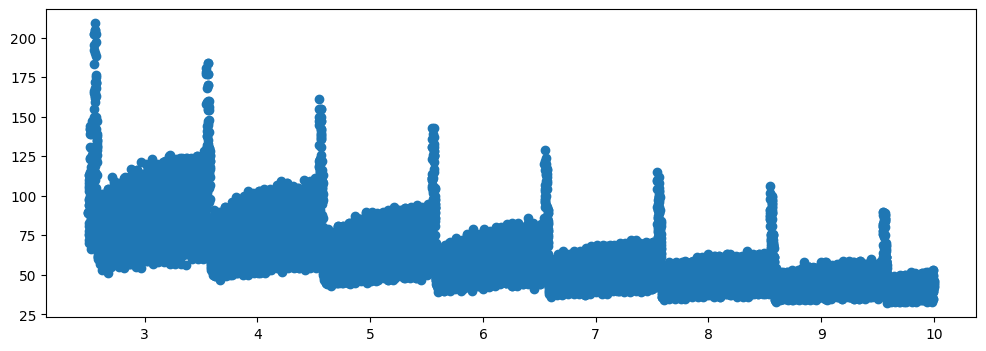

max spot_2


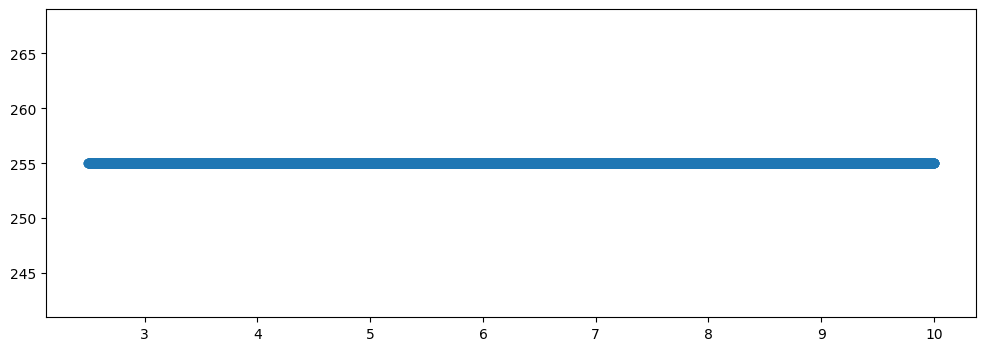

sum spot_1


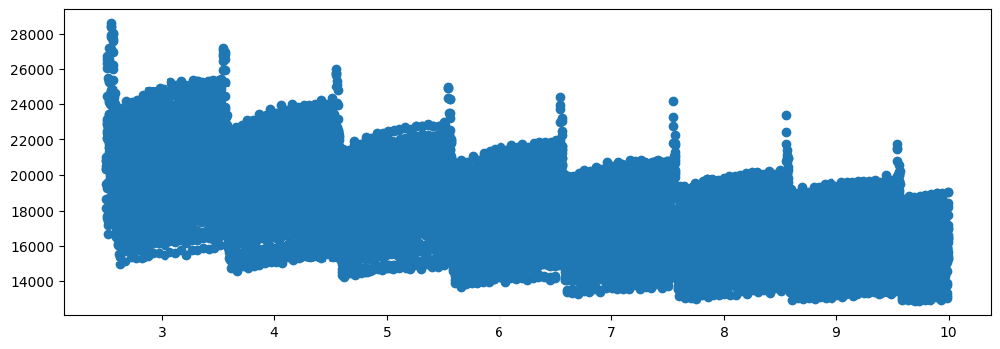

sum spot_2


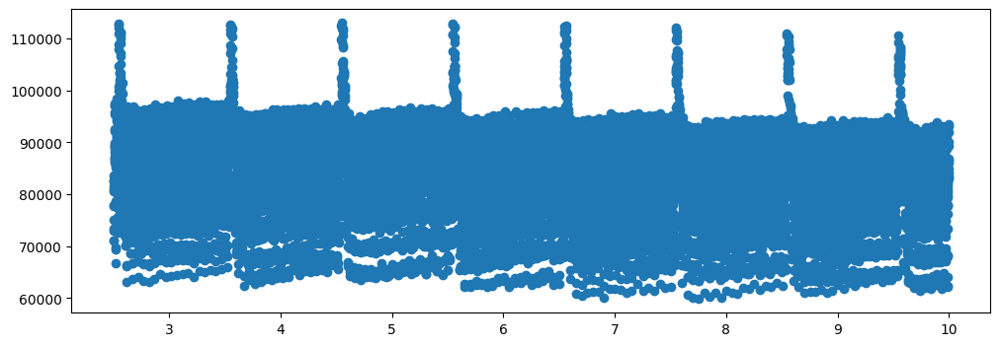

mean spot_1


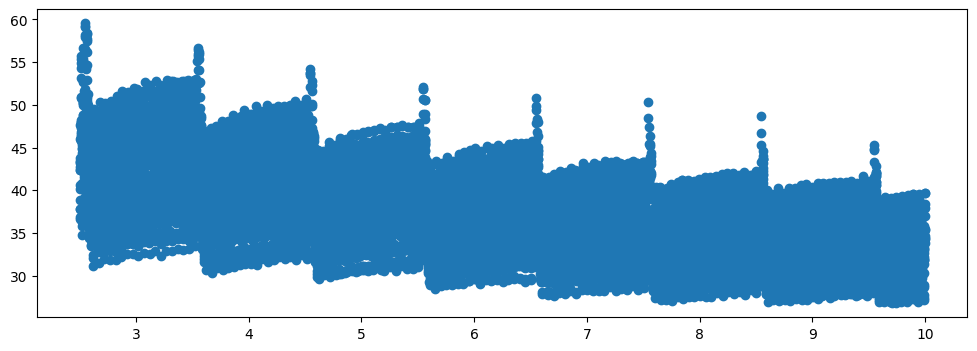

mean spot_2


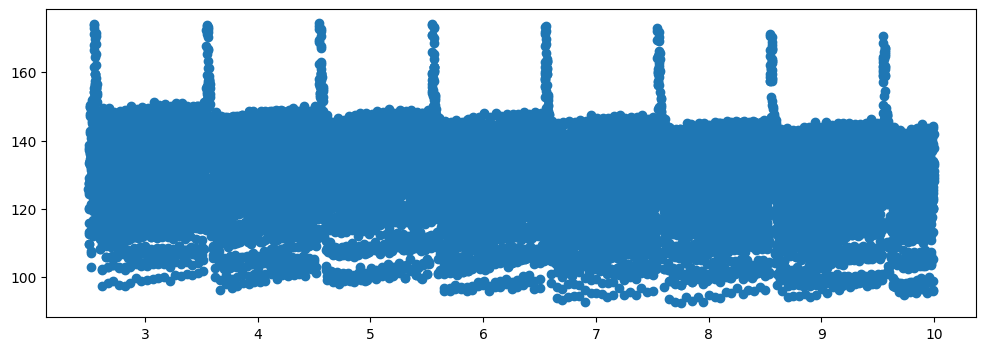

In [182]:
for i, metric in enumerate(['max', 'sum', 'mean']):
    for j, spot in enumerate(['spot_1', 'spot_2']):
        print(metric, spot)
        plt.figure(figsize=(12,4))
        time = np.linspace(0, len(metric_data_list[i*3+j])/2000, len(metric_data_list[i*3+j]))
        plt.scatter(time[5000:20000], metric_data_list[i*3+j][5000:20000])
        plt.show()

In [189]:
camera_freq = 2000
laser_freq = 1
detect_param={'step_size':3, 'prominence':10}
step_size = detect_param['step_size']
prominence = detect_param['prominence']
viz_curves=True
viz_fittings=True
viz_ab=True
n_std=3

sample_x = time
sample_y = metric_data_list[0]
data = np.stack([sample_x, sample_y], axis=1)

In [197]:

def analyze_rheed_data(data, camera_freq, laser_freq, detect_param={'step_size':3, 'prominence':10}, viz_curves=False, viz_fittings=False, viz_ab=False, n_std=3, trim_first=0):
    if isinstance(data, str):
        data = np.loadtxt(data)
    sample_x, sample_y = data[:,0], data[:,1]
#     sample_y = signal.savgol_filter(sample_y, window_length=51, polyorder=3)

    step_size = detect_param['step_size']
    prominence = detect_param['prominence']

    # plt.plot(sample_x, sample_y)
    # plt.show()
    
    x_peaks, xs, ys = detect_peaks(sample_x, sample_y, camera_freq=camera_freq, laser_freq=laser_freq, step_size=step_size, prominence=prominence)
    
    if trim_first != 0:
        xs_trimed, ys_trimed = [], []
        for x, y in zip(xs, ys):
            ys_trimed.append(y[trim_first:])
            xs_trimed.append(np.linspace(x[0], x[-1], len(y[trim_first:])))
        xs, ys = xs_trimed, ys_trimed
    
    if viz_curves:
        xs_sample, ys_sample = xs[::1], ys[::1]
        fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
        Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

    parameters_all, x_list_all, info = fit_curves(xs, ys, x_peaks, sample_x)
    [xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, labels_all, losses_all] = info
    
    if viz_fittings:
        Viz.plot_fit_details(xs_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, index_list=range(len(xs_all)), figsize=(12,2*len(x_peaks)//6+1))

    if viz_ab:
        fig, axes = layout_fig(4, 1, figsize=(12, 3*4))
        Viz.plot_curve(axes[0], sample_x, sample_y, plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity (a.u.)', yaxis_style='sci')
        Viz.plot_curve(axes[1], x_list_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted a (a.u.)')
        Viz.plot_curve(axes[2], x_list_all, parameters_all[:,1], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted b (a.u.)')
        Viz.plot_curve(axes[3], x_list_all, parameters_all[:,2], plot_type='lineplot', xlabel='Time (s)', ylabel='Characteristic Time (s)')
        plt.show()

    fig, ax1 = plt.subplots(1, 1, figsize=(8, 2.5), layout='compressed')
    ax1.scatter(sample_x, sample_y, color='k', s=1)
    Viz.set_labels(ax1, xlabel='Time (s)', ylabel='Intensity (a.u.)', ticks_both_sides=False)

    # n_std = 3
    tau = parameters_all[:,2]
    x_clean = x_list_all[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]
    tau = tau[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]

    x_clean = x_clean[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
    tau = tau[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
    # print('mean of tau:', np.mean(tau))

    ax2 = ax1.twinx()
    ax2.scatter(x_list_all, parameters_all[:,2], color=seq_colors[0], s=3)
    ax2.plot(x_clean,  tau, color='#bc5090', markersize=3)
    Viz.set_labels(ax2, ylabel='Characteristic Time (s)', yaxis_style='lineplot', ylim=(-0.05, 0.8), ticks_both_sides=False)
    ax2.tick_params(axis="y", color='k', labelcolor=seq_colors[0])
    ax2.set_ylabel('Characteristic Time (s)', color=seq_colors[0])
    plt.title('mean of tau: '+str(np.mean(tau)))
    plt.show()
    return parameters_all, x_list_all, info, tau

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:414: UserWarning:

The figure layout has changed to tight



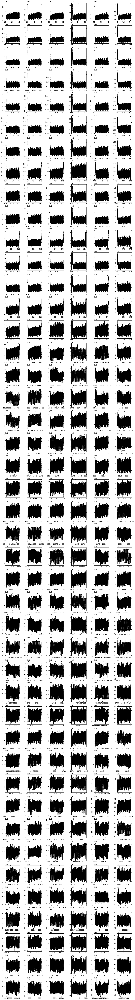

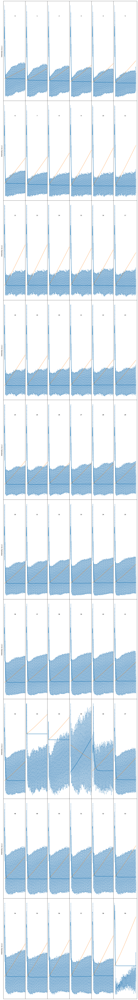

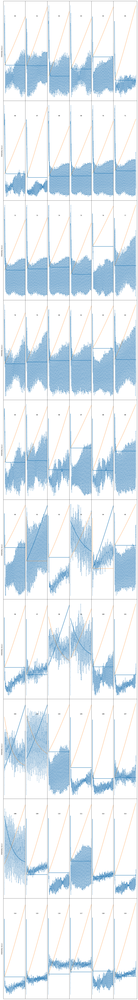

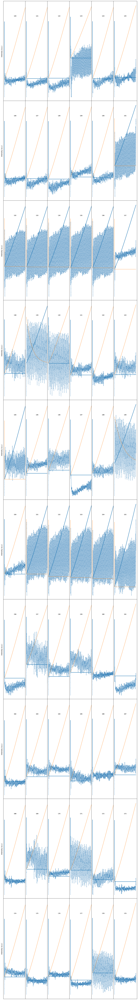

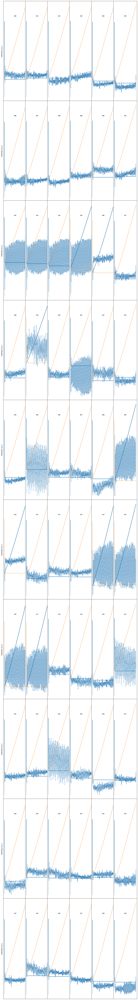

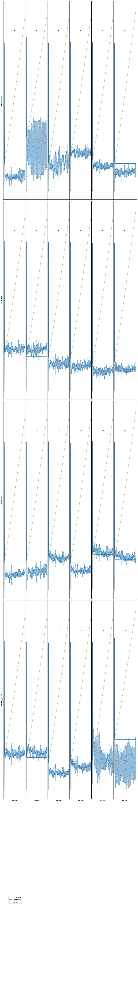

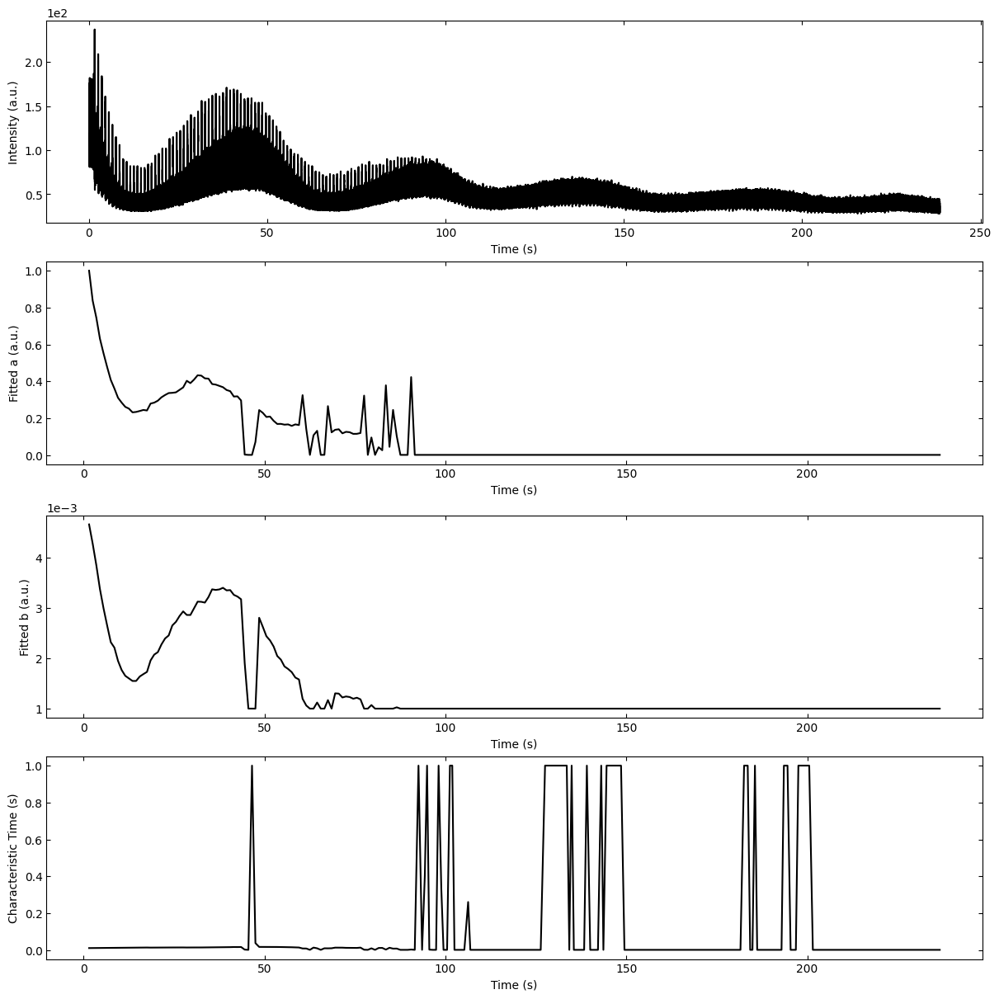

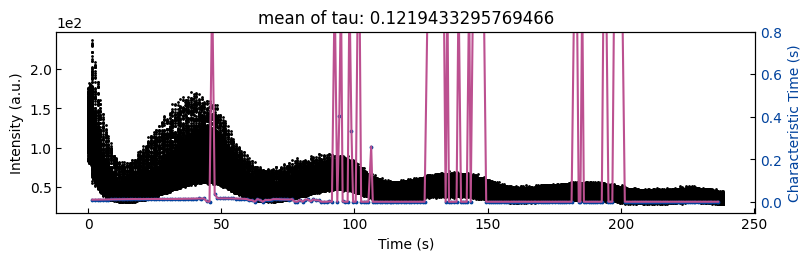

In [198]:
parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, detect_param, viz_curves, 
                                                           viz_fittings, viz_ab, n_std=3)

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:414: UserWarning:

The figure layout has changed to tight



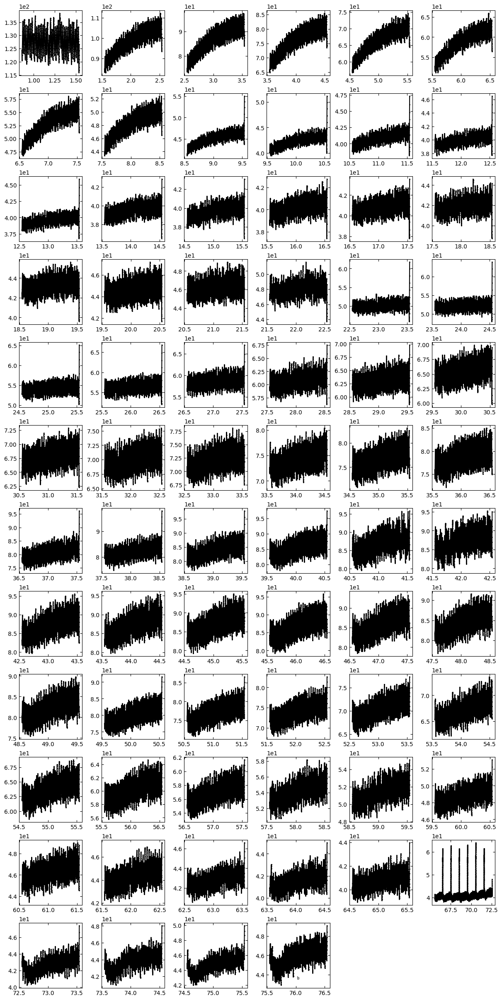

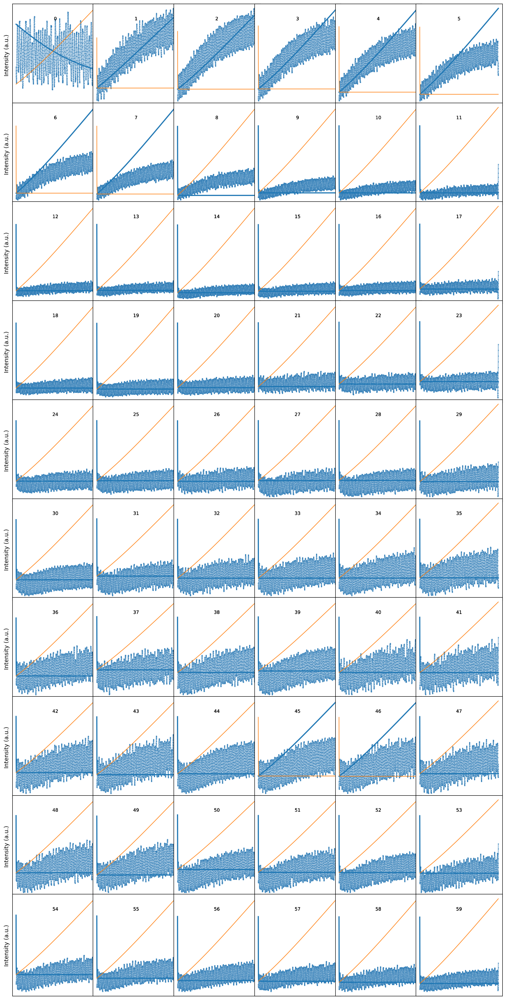

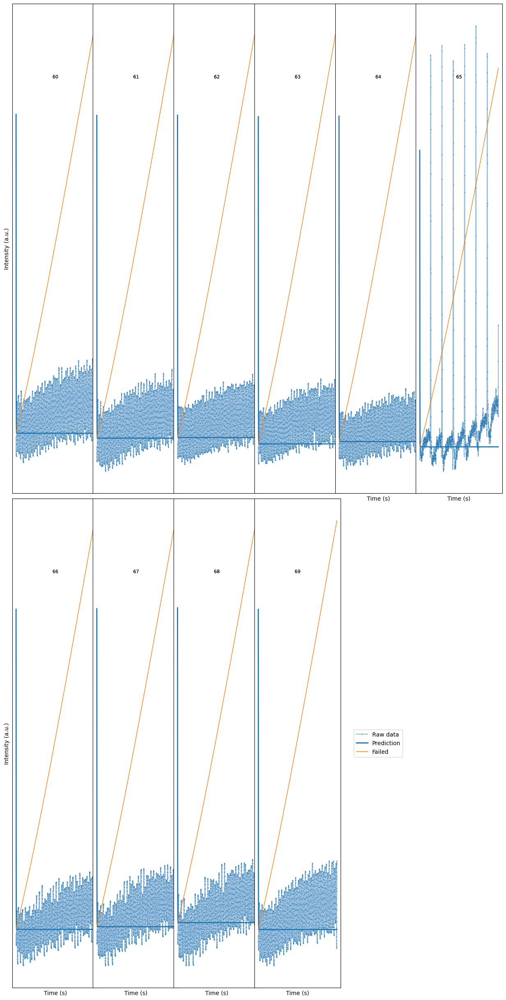

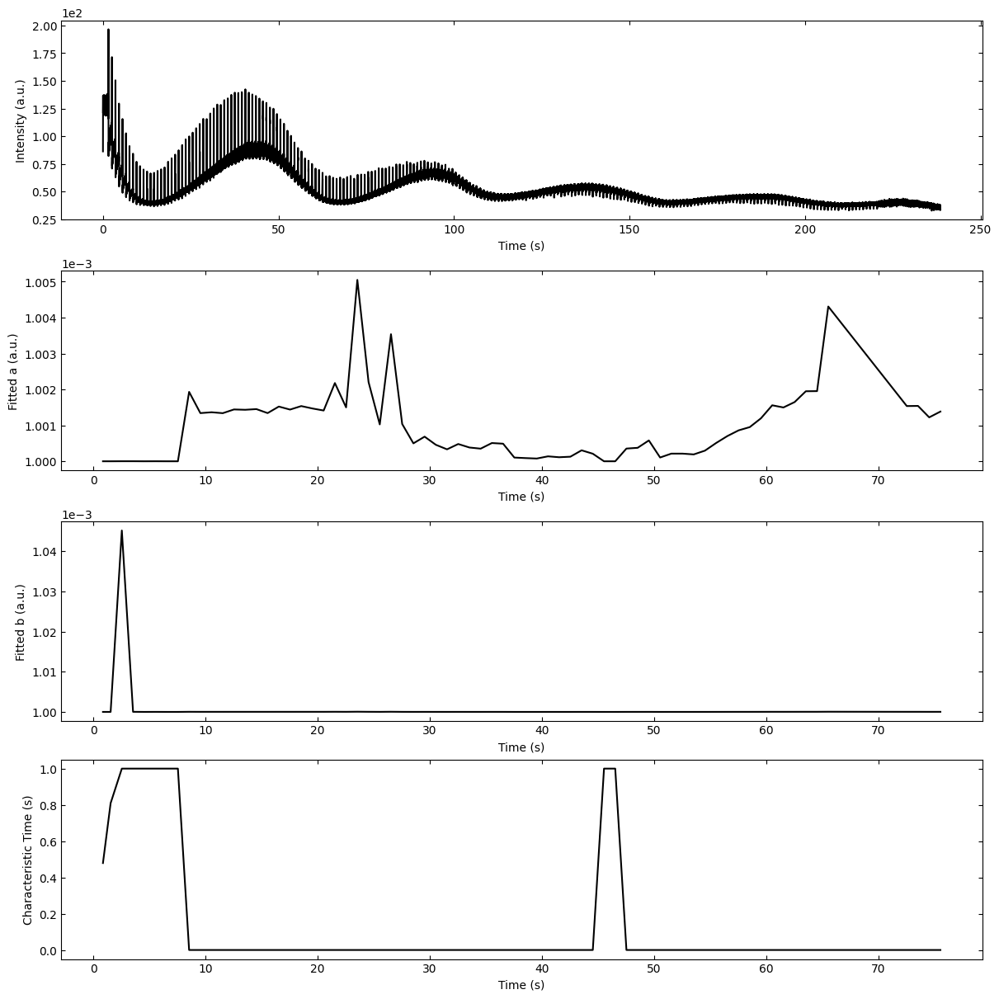

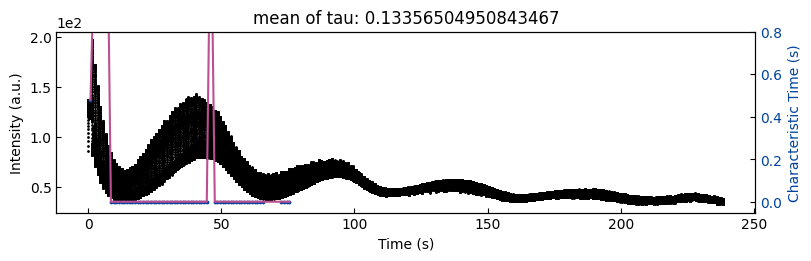

In [195]:
parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, detect_param, viz_curves, 
                                                           viz_fittings, viz_ab, n_std=3, trim_first=120)

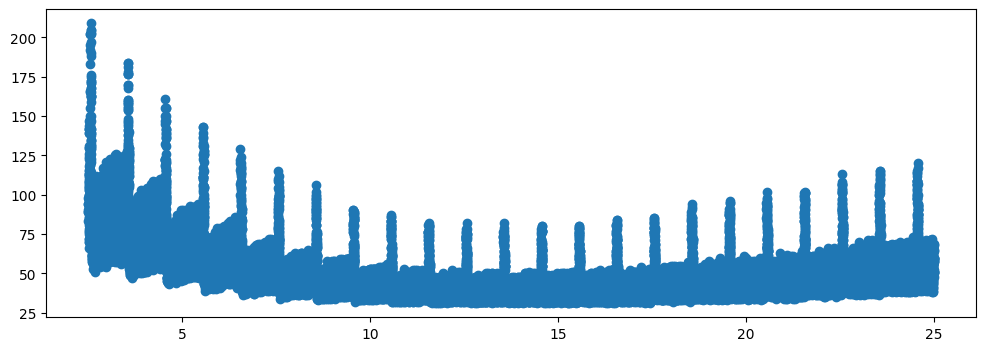

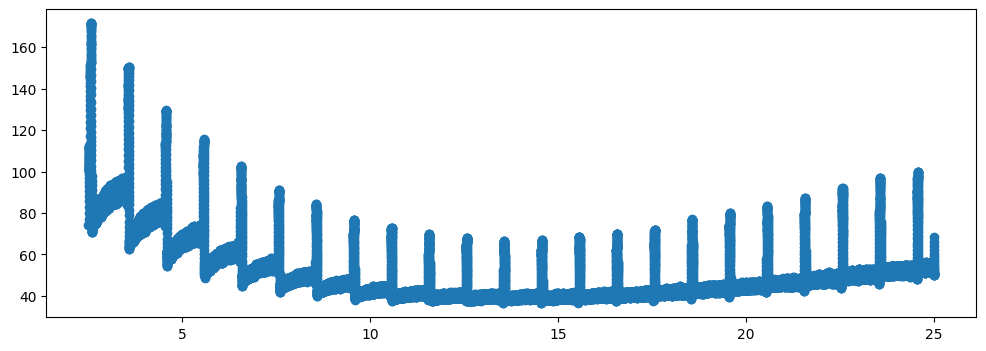

In [146]:
plt.figure(figsize=(12,4))
plt.scatter(sample_x, sample_y)
plt.show()

plt.figure(figsize=(12,4))
smooth_y = signal.savgol_filter(sample_y, window_length=51, polyorder=3)
plt.scatter(sample_x, smooth_y)
plt.show()

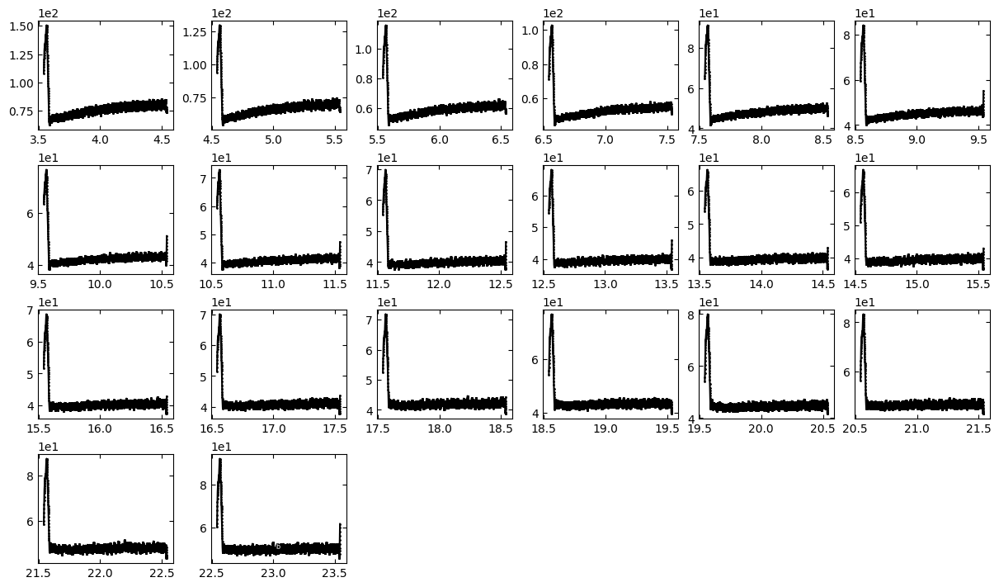

In [148]:
x_peaks, xs, ys = detect_peaks(sample_x, smooth_y, camera_freq=camera_freq, laser_freq=laser_freq, step_size=step_size, prominence=prominence)

if viz_curves:
    xs_sample, ys_sample = xs[::1], ys[::1]
    fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
    Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

In [174]:
xs_trimed, ys_trimed = [], []
for x, y in zip(xs, ys):
    ys_trimed.append(y[90:])
    xs_trimed.append(np.linspace(x[0], x[-1], len(y[90:])))

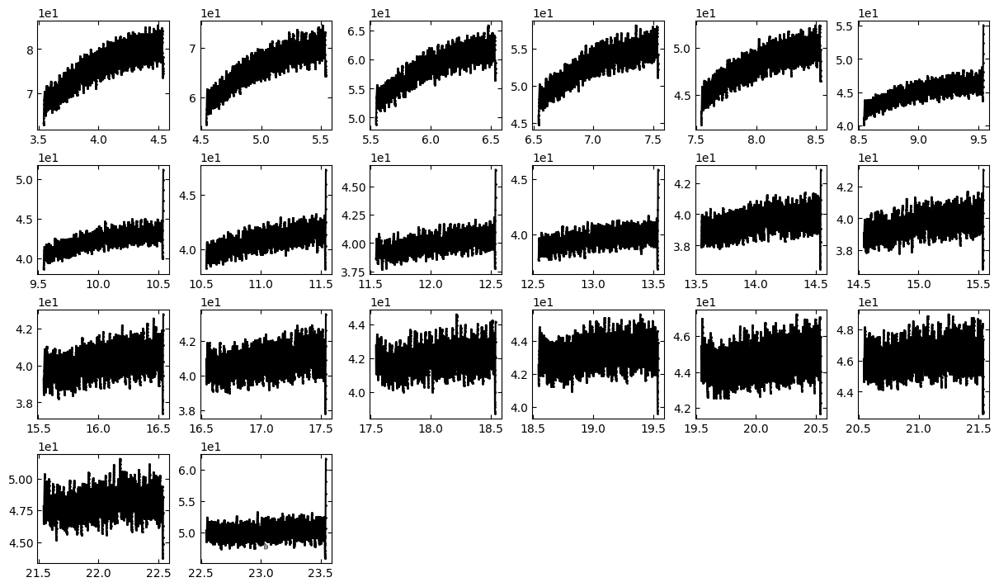

In [175]:
if viz_curves:
    xs_sample, ys_sample = xs_trimed[::1], ys_trimed[::1]
    fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
    Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

In [177]:
xs, ys = xs_trimed, ys_trimed

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:444: UserWarning:

The figure layout has changed to tight



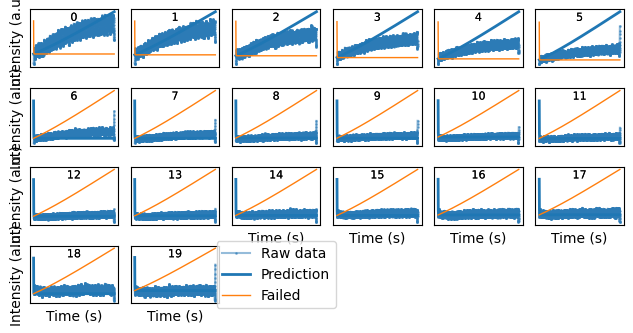

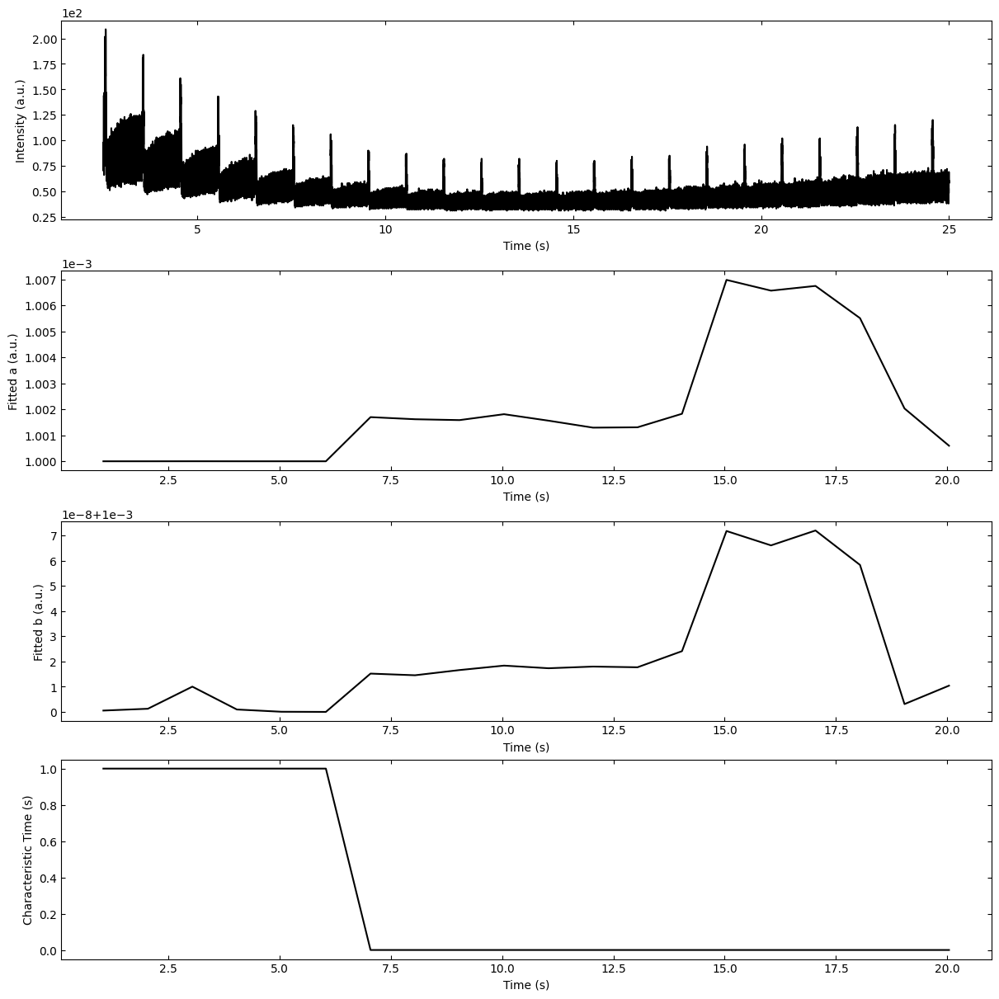

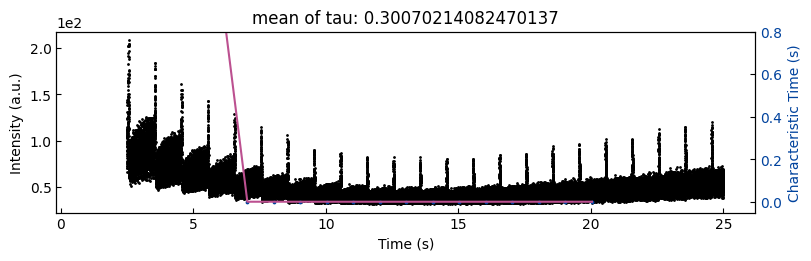

In [178]:
parameters_all, x_list_all, info = fit_curves(xs, ys, x_peaks, sample_x)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, labels_all, losses_all] = info

if viz_fittings:
    Viz.plot_fit_details(xs_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, index_list=range(len(xs_all)), figsize=(12,0.3*len(x_peaks)//6+1))

if viz_ab:
    fig, axes = layout_fig(4, 1, figsize=(12, 3*4))
    Viz.plot_curve(axes[0], sample_x, sample_y, plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity (a.u.)', yaxis_style='sci')
    Viz.plot_curve(axes[1], x_list_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted a (a.u.)')
    Viz.plot_curve(axes[2], x_list_all, parameters_all[:,1], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted b (a.u.)')
    Viz.plot_curve(axes[3], x_list_all, parameters_all[:,2], plot_type='lineplot', xlabel='Time (s)', ylabel='Characteristic Time (s)')
    plt.show()

fig, ax1 = plt.subplots(1, 1, figsize=(8, 2.5), layout='compressed')
ax1.scatter(sample_x, sample_y, color='k', s=1)
Viz.set_labels(ax1, xlabel='Time (s)', ylabel='Intensity (a.u.)', ticks_both_sides=False)

# n_std = 3
tau = parameters_all[:,2]
x_clean = x_list_all[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]
tau = tau[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]

x_clean = x_clean[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
tau = tau[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
# print('mean of tau:', np.mean(tau))

ax2 = ax1.twinx()
ax2.scatter(x_list_all, parameters_all[:,2], color=seq_colors[0], s=3)
ax2.plot(x_clean,  tau, color='#bc5090', markersize=3)
Viz.set_labels(ax2, ylabel='Characteristic Time (s)', yaxis_style='lineplot', ylim=(-0.05, 0.8), ticks_both_sides=False)
ax2.tick_params(axis="y", color='k', labelcolor=seq_colors[0])
ax2.set_ylabel('Characteristic Time (s)', color=seq_colors[0])
plt.title('mean of tau: '+str(np.mean(tau)))
plt.show()

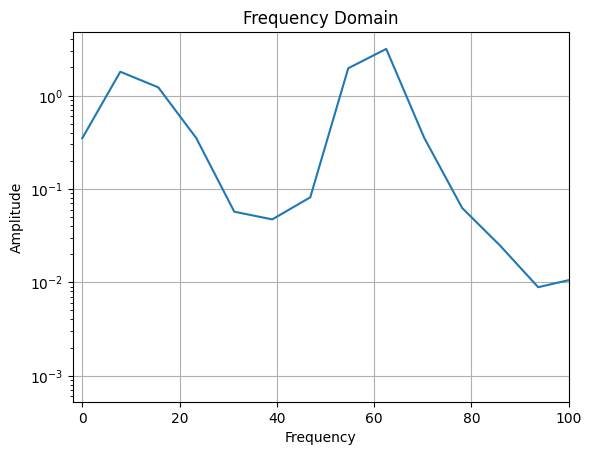

In [95]:
from scipy import signal

freqs, fft = signal.welch(y, fs=2000, nperseg=256)
plt.figure()
plt.semilogy(freqs, fft)
plt.title('Frequency Domain')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.xlim(-2,100)
plt.grid(True)

In [96]:
b, a = signal.butter(4, 0.05, btype='low')
filtered_data = signal.lfilter(b, a, y)

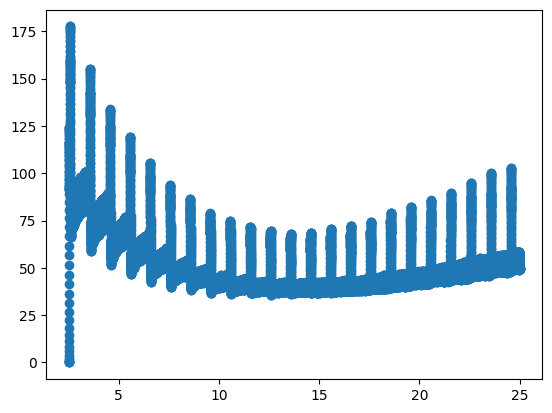

In [97]:
plt.scatter(x, filtered_data)

In [98]:
import glob, re
import numpy as np
import matplotlib.pyplot as plt
from m3_learning.viz.layout import layout_fig
from m3_learning.RHEED.Viz import Viz
from m3_learning.RHEED.Analysis import detect_peaks, process_rheed_data , fit_exp_function
seq_colors = ['#00429d','#2e59a8','#4771b2','#5d8abd','#73a2c6','#8abccf','#a5d5d8','#c5eddf','#ffffe0']

def fit_curves(xs, ys, x_peaks, sample_x):
    fit_settings = {'savgol_window_order': (15, 3), 'pca_component': 10, 'I_diff': 15000, 
                'unify':False, 'bounds':[0.001, 1], 'p_init':[0.1, 0.4, 0.1]}

    x_end = 0
    length_list = []
    for xi in xs:
        length_list.append(len(xi))

    xs, ys = process_rheed_data(xs, ys, length=int(np.mean(length_list)), savgol_window_order=fit_settings['savgol_window_order'], 
                                pca_component=fit_settings['pca_component'])        

    parameters_all, x_list_all = [], []
    xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all = [], [], [], [], [], []
    labels_all, losses_all =  [], []

    # fit exponential function
    parameters, info = fit_exp_function(xs, ys, growth_name='growth_1', fit_settings=fit_settings)        
    parameters_all.append(parameters)
    xs, ys, ys_fit, ys_nor, ys_nor_fit, ys_nor_fit_failed, labels, losses = info
    xs_all.append(xs)
    ys_all.append(ys)
    ys_fit_all+=ys_fit
    ys_nor_all+=ys_nor
    ys_nor_fit_all+=ys_nor_fit
    ys_nor_fit_failed_all+=ys_nor_fit_failed
    labels_all += labels
    losses_all += losses

    x_list = x_peaks[:-1] + x_end
    x_end = round(x_end + (len(sample_x)+0)/30, 2)
    x_list_all.append(x_list)
        
    parameters_all = np.concatenate(parameters_all, 0)
    x_list_all = np.concatenate(x_list_all)[:len(parameters_all)]
    xs_all = np.concatenate(xs_all)
    ys_all = np.concatenate(ys_all)
    ys_nor_all = np.array(ys_nor_all)
    ys_nor_fit_all = np.array(ys_nor_fit_all)
    losses_all = np.array(losses_all)
    ys_nor_fit_all_failed = np.array(ys_nor_fit_failed_all)
    return parameters_all, x_list_all, [xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_all_failed, labels_all, losses_all]


In [99]:
camera_freq = 2000
laser_freq = 1
detect_param={'step_size':3, 'prominence':10}
step_size = detect_param['step_size']
prominence = detect_param['prominence']

viz_curves=True
viz_fittings=True
viz_ab=True
n_std=3

sample_x, sample_y = x, y

step_size = 3

In [108]:
dist = int(2000/1*0.6)
step = np.hstack((np.ones(step_size), -1*np.ones(step_size)))
dary_step = np.convolve(y, step, mode='valid')
dary_step = np.abs(dary_step)

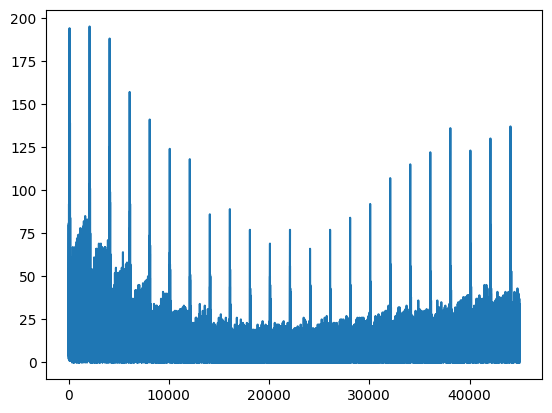

In [109]:
plt.plot(dary_step)

In [115]:
y_ = np.max(y) - y

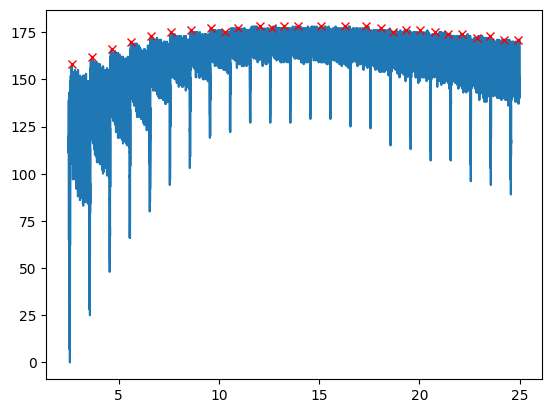

In [116]:
x_peaks, properties = signal.find_peaks(y_, prominence=prominence, distance=dist)
plt.plot(x, y_)
plt.plot(x[x_peaks], y_[x_peaks], 'x', label='Detected Peaks', color='red')  # Mark detected peaks

In [78]:
x_peaks, xs, ys = detect_peaks(x, y, camera_freq=camera_freq, laser_freq=laser_freq, step_size=step_size, prominence=prominence)

if viz_curves:
    xs_sample, ys_sample = xs[::1], ys[::1]
    fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
    Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

ValueError: Number of rows must be a positive integer, not 0

<Figure size 1200x100 with 0 Axes>

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:444: UserWarning:

The figure layout has changed to tight



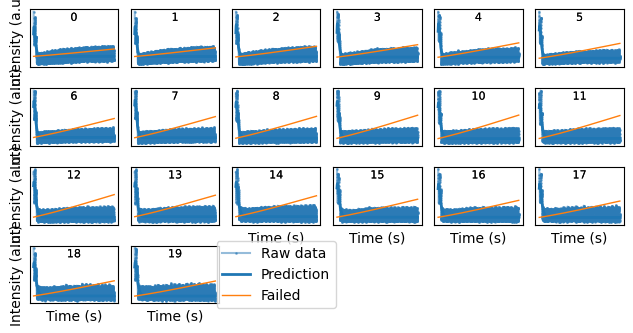

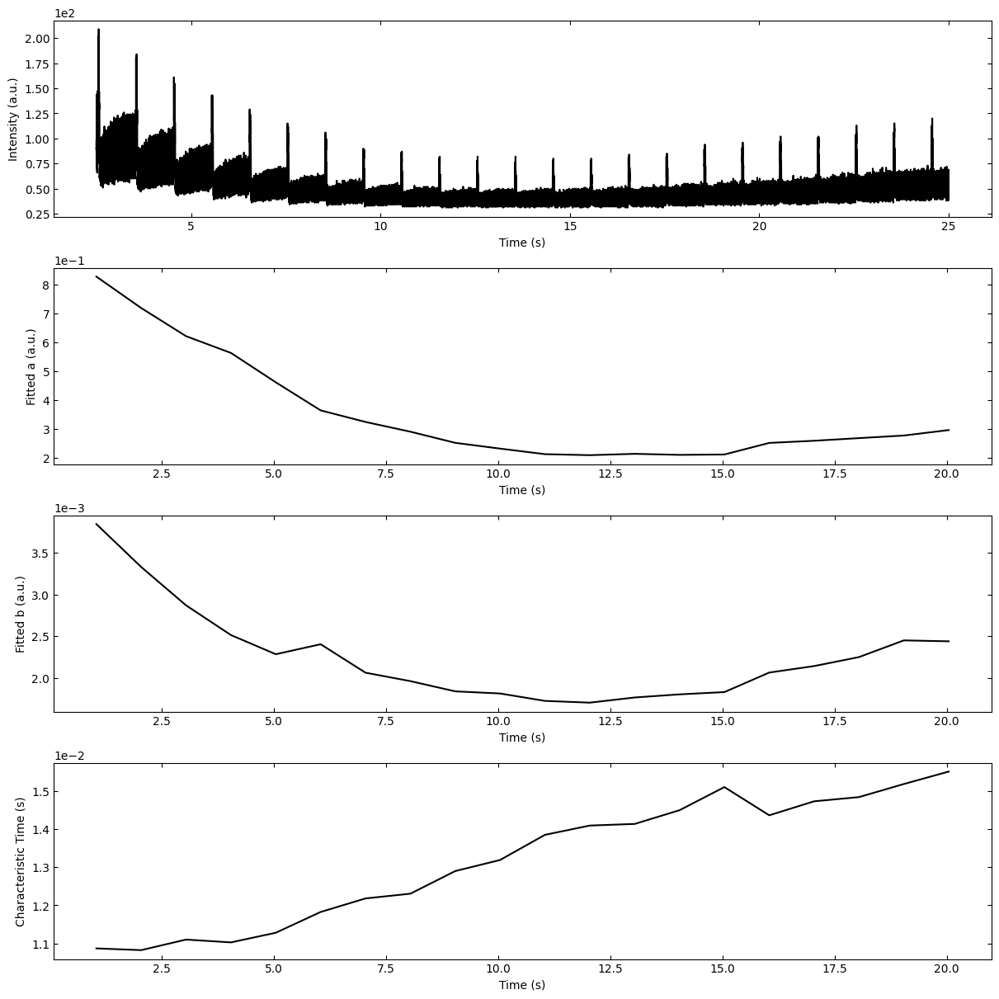

In [62]:
parameters_all, x_list_all, info = fit_curves(xs, ys, x_peaks, sample_x)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, labels_all, losses_all] = info

if viz_fittings:
    Viz.plot_fit_details(xs_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, index_list=range(len(xs_all)), figsize=(12,0.3*len(x_peaks)//6+1))

if viz_ab:
    fig, axes = layout_fig(4, 1, figsize=(12, 3*4))
    Viz.plot_curve(axes[0], sample_x, sample_y, plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity (a.u.)', yaxis_style='sci')
    Viz.plot_curve(axes[1], x_list_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted a (a.u.)')
    Viz.plot_curve(axes[2], x_list_all, parameters_all[:,1], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted b (a.u.)')
    Viz.plot_curve(axes[3], x_list_all, parameters_all[:,2], plot_type='lineplot', xlabel='Time (s)', ylabel='Characteristic Time (s)')
    plt.show()

In [ ]:
fig, ax1 = plt.subplots(1, 1, figsize=(8, 2.5), layout='compressed')
ax1.scatter(sample_x, sample_y, color='k', s=1)
Viz.set_labels(ax1, xlabel='Time (s)', ylabel='Intensity (a.u.)', ticks_both_sides=False)

# n_std = 3
tau = parameters_all[:,2]
x_clean = x_list_all[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]
tau = tau[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]

x_clean = x_clean[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
tau = tau[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
# print('mean of tau:', np.mean(tau))

ax2 = ax1.twinx()
ax2.scatter(x_list_all, parameters_all[:,2], color=seq_colors[0], s=3)
ax2.plot(x_clean,  tau, color='#bc5090', markersize=3)
Viz.set_labels(ax2, ylabel='Characteristic Time (s)', yaxis_style='lineplot', ylim=(-0.05, 0.8), ticks_both_sides=False)
ax2.tick_params(axis="y", color='k', labelcolor=seq_colors[0])
ax2.set_ylabel('Characteristic Time (s)', color=seq_colors[0])
plt.title('mean of tau: '+str(np.mean(tau)))
plt.show()

max spot_1


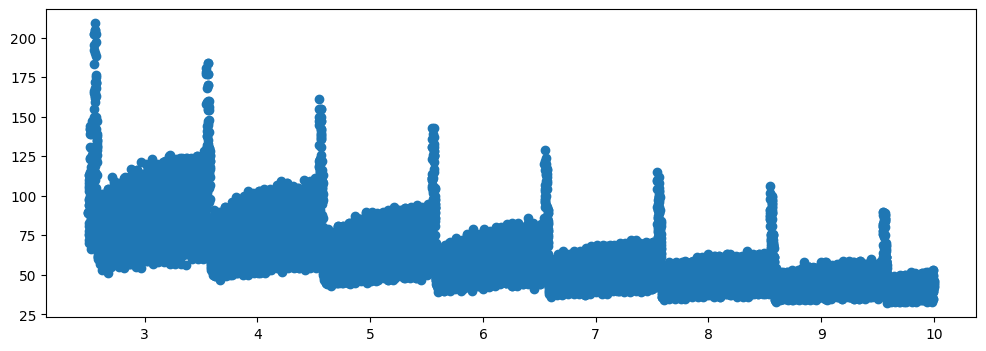

max spot_2


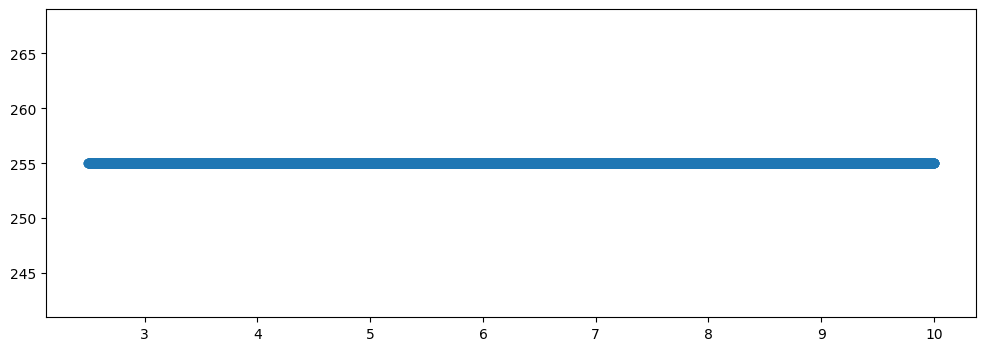

sum spot_1


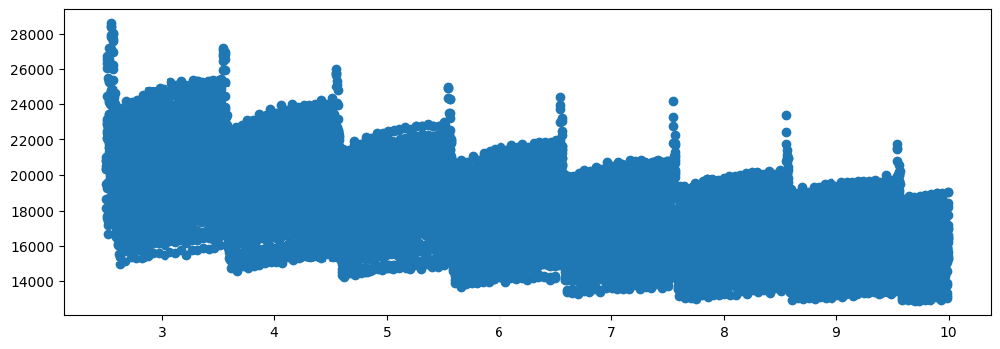

sum spot_2


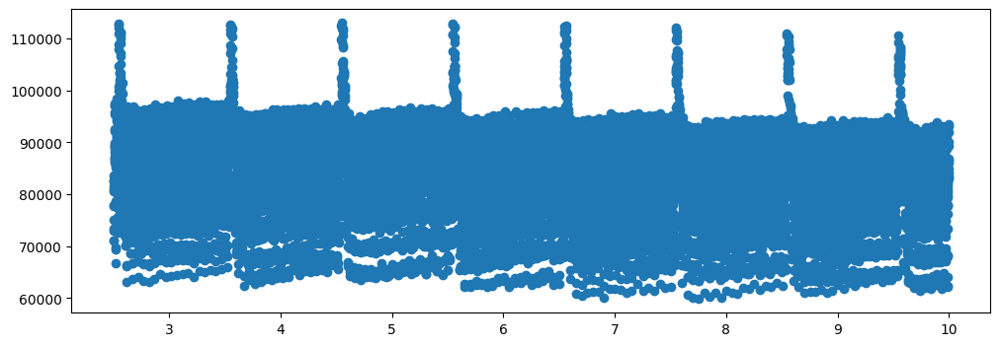

mean spot_1


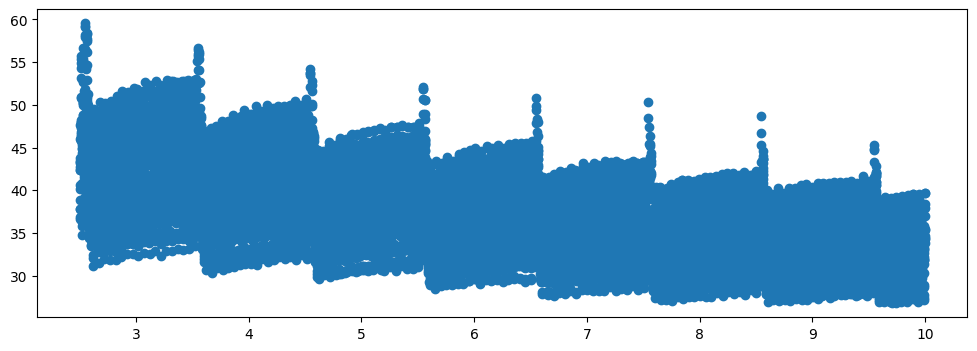

mean spot_2


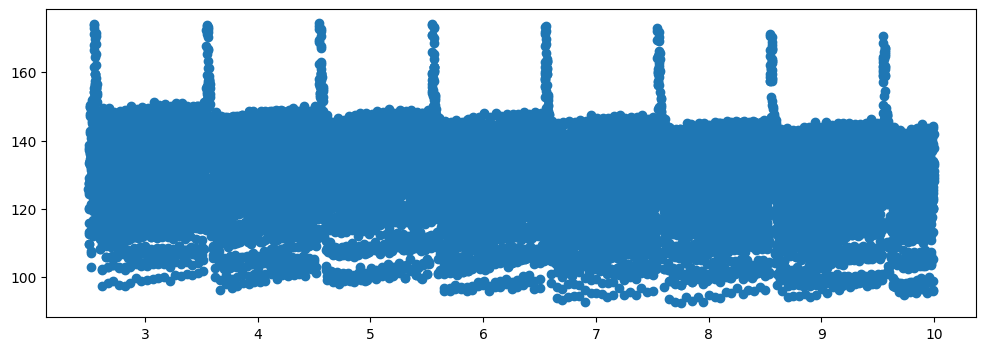

#### 2.1.4 generate the dataset

In [5]:
%%time
parameters_file_path = 'F:/UMich/J14_set2_gaussian_fit_parameters_08252023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(D1_spot, crop_dict, fit_function)
processor.write_h5_file(parameters_file_path, growth_names, replace=True, num_workers=12)

temp350:
  spot_1 generation started:
    0 - 50000 ...


KeyboardInterrupt: 

#### 2.1.5 Exam the dataset

In [6]:
parameters_file_path = 'F:/UMich/J14_set2_gaussian_fit_parameters_08252023.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='J14_350C')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D1_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

KeyError: "Unable to open object (object 'spot_2' doesn't exist)"